# 📘 Notebook de Análise de Imagens 

Este notebook apresenta um pipeline completo de análise de imagens sem classificação, focado em extrair e visualizar características visuais utilizando OpenCV e matplotlib.

---

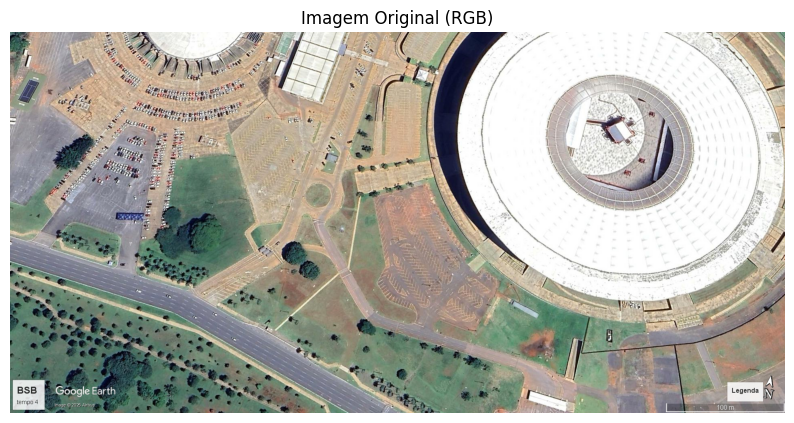

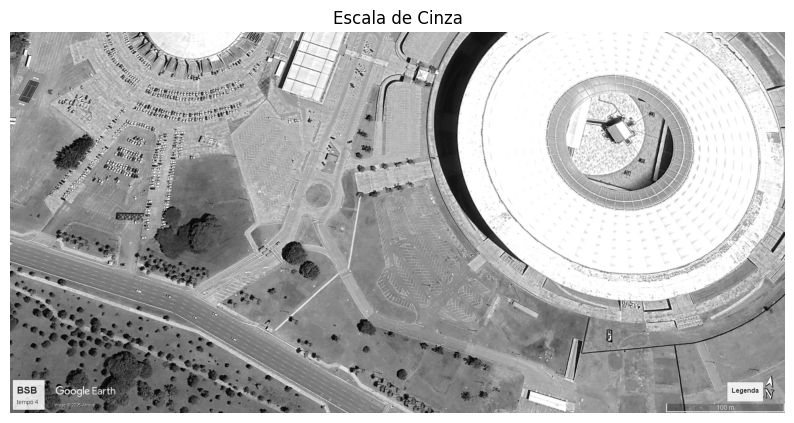

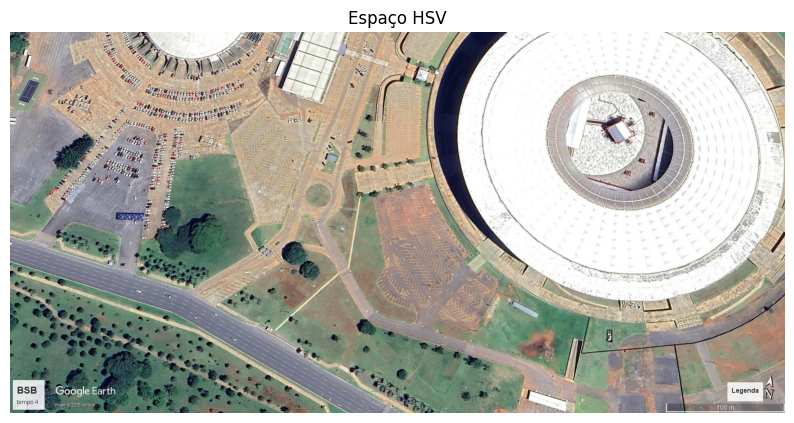

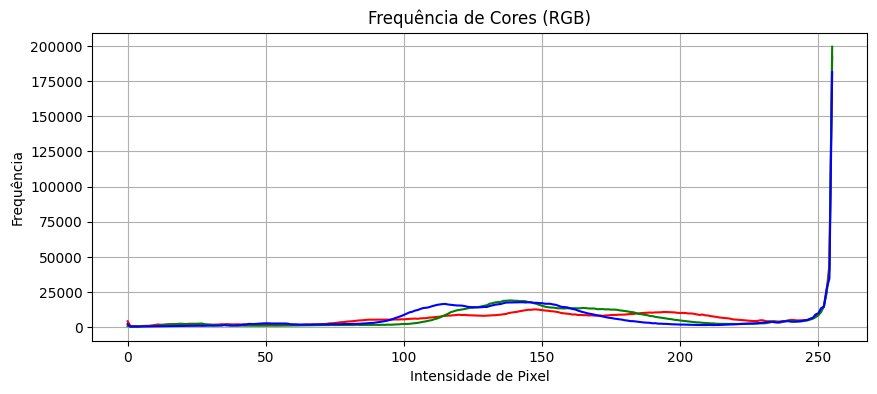

In [1]:
# Parte 1 Carregamento, conversão de cores e histograma
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Função para carregar e exibir a imagem em RGB
def load_image(filepath):
    image_bgr = cv2.imread(filepath)
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    return image_bgr, image_rgb

# Exibir imagem com matplotlib
def show_image(title, image, gray):
    if gray:
        plt.figure(figsize=(10, 5))
        plt.imshow(image, cmap='gray')
        plt.title(title)
        plt.axis('off')
        plt.show()
    else:
        plt.figure(figsize=(10, 5))
        plt.imshow(image)
        plt.title(title)
        plt.axis('off')
        plt.show()

# Função para converter em outros espaços de cor
def convert_colors(image_bgr):
    gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)
    hsv = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2HSV)
    return gray, hsv

# Função para plotar histograma
def plot_histogram(image_rgb):
    colors = ('r', 'g', 'b')
    plt.figure(figsize=(10, 4))
    for i, color in enumerate(colors):
        hist = cv2.calcHist([image_rgb], [i], None, [256], [0, 256])
        plt.plot(hist, color=color)
    plt.title('Frequência de Cores (RGB)')
    plt.xlabel('Intensidade de Pixel')
    plt.ylabel('Frequência')
    plt.grid(True)
    plt.show()

# Exemplo de uso
image_path = './D/classifD.jpg'  # coloque o caminho da sua imagem aqui
image_bgr, image_rgb = load_image(image_path)
show_image("Imagem Original (RGB)", image_rgb, False)

gray, hsv = convert_colors(image_bgr)
show_image("Escala de Cinza", gray, True)
show_image("Espaço HSV", cv2.cvtColor(hsv, cv2.COLOR_HSV2RGB), False)  # para exibir no matplotlib

plot_histogram(image_rgb)


In [2]:
print(type(gray))  # Deve ser <class 'numpy.ndarray'>
print(gray[:5])  # Primeiras 5 linhas da matriz
print("Tipos de dados:", gray.dtype)  # Deve ser uint8
print("Altura x Largura:" ,gray.shape)  # Deve ser (altura, largura)

total_pixels = gray.shape[0] * gray.shape[1]
print(f'Total de pixels: {total_pixels}')


<class 'numpy.ndarray'>
[[108 109 108 ... 143 138 116]
 [106 108 110 ... 121 123 133]
 [108 110 112 ... 125 123 134]
 [114 114 112 ... 140 134 126]
 [116 113 109 ... 132 132 131]]
Tipos de dados: uint8
Altura x Largura: (944, 1920)
Total de pixels: 1812480


## 🎨 Canais RGB
O modelo **RGB (Red, Green, Blue)** é o padrão para representar imagens digitais em cores. Cada pixel é composto por três valores que indicam a intensidade das cores **vermelho**, **verde** e **azul**, variando de 0 a 255. A combinação desses três canais gera qualquer cor visível na tela.

- 📌 Exemplo: Um pixel `(255, 0, 0)` é totalmente vermelho.
- Para manipular cores individualmente, pode-se separar os canais usando bibliotecas como OpenCV.


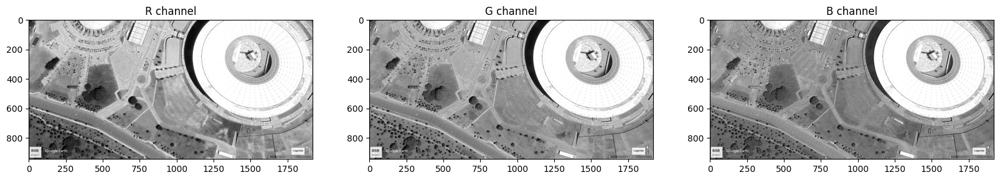

In [3]:
# Isolate RGB channels
r = image_rgb[:,:,0]
g = image_rgb[:,:,1]
b = image_rgb[:,:,2]

# Visualize the individual color channels
f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20,10))
ax1.set_title('R channel')
ax1.imshow(r, cmap='gray')
ax2.set_title('G channel')
ax2.imshow(g, cmap='gray')
ax3.set_title('B channel')
ax3.imshow(b, cmap='gray')

## 🎨 Canais HSV
O modelo **HSV (Hue, Saturation, Value)** descreve as cores de forma mais próxima da percepção humana:

- **Hue (Matiz)**: Representa o tom da cor (0° a 180° no OpenCV, onde 0 = vermelho, 60 = amarelo, 120 = verde).
- **Saturation (Saturação)**: Intensidade da cor (0 a 255). Valores baixos produzem tons acinzentados.
- **Value (Brilho)**: Define o quão claro ou escuro é o pixel (0 a 255).

✅ O HSV é ideal para segmentação de cores, pois permite isolar uma cor independente do brilho.


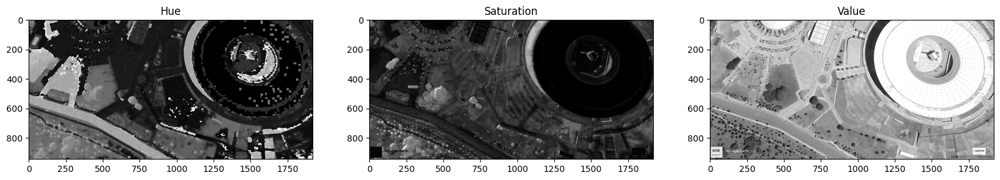

In [4]:

# HSV channels
h = hsv[:,:,0]
s = hsv[:,:,1]
v = hsv[:,:,2]

f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20,10))

ax1.set_title('Hue')
ax1.imshow(h, cmap='gray')

ax2.set_title('Saturation')
ax2.imshow(s, cmap='gray')

ax3.set_title('Value')
ax3.imshow(v, cmap='gray')

## 🎯 Máscara HSV
Uma **máscara HSV** é uma técnica para filtrar partes da imagem que pertencem a uma faixa de cor específica.

- Utiliza-se a função `cv2.inRange(hsv_image, lower_bound, upper_bound)`.
- Pixels dentro do intervalo ficam brancos (**255**), e fora ficam pretos (**0**).
- Muito usada para detectar objetos com cores definidas (ex: detectar apenas áreas verdes).


In [5]:
# Define our color selection criteria in HSV values
lower_hue = np.array([40,20,20]) 
upper_hue = np.array([85,255,255])

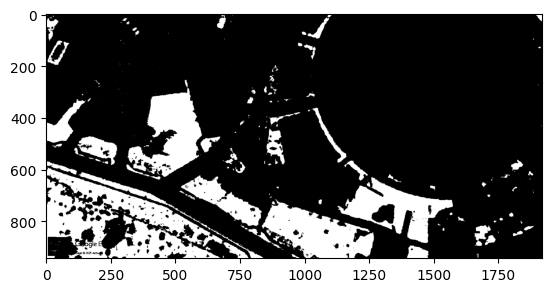

In [6]:

# Define the masked area in HSV space
mask_hsv = cv2.inRange(hsv, lower_hue, upper_hue)

# Vizualize the mask
plt.imshow(mask_hsv, cmap="gray")

Percentual de verde na imagem: 18.81%


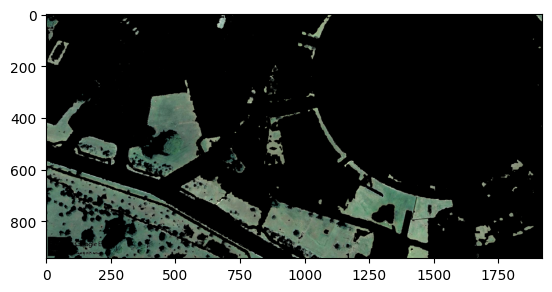

In [7]:

# Calcular o percentual de pixels que **não são pretos** (ou seja, pertencem à máscara)
total_pixels = mask_hsv.size
green_pixels = cv2.countNonZero(mask_hsv)  # Conta os pixels diferentes de zero na máscara

percentual_verde = (green_pixels / total_pixels) * 100

print(f"Percentual de verde na imagem: {percentual_verde:.2f}%")

# mask the image
masked_image = np.copy(image_rgb)
masked_image[mask_hsv==0] = [0,0,0]

# Vizualize the mask
plt.imshow(masked_image)

A **equalização de histograma** redistribui os níveis de intensidade para melhorar o contraste da imagem.

- Útil para imagens escuras ou lavadas.
- Realça detalhes em áreas pouco visíveis.
- Em OpenCV: `cv2.equalizeHist()`, aplicável apenas em imagens em escala de cinza.

🔸 Para imagens coloridas, aplica-se em cada canal ou usa-se técnicas como CLAHE.


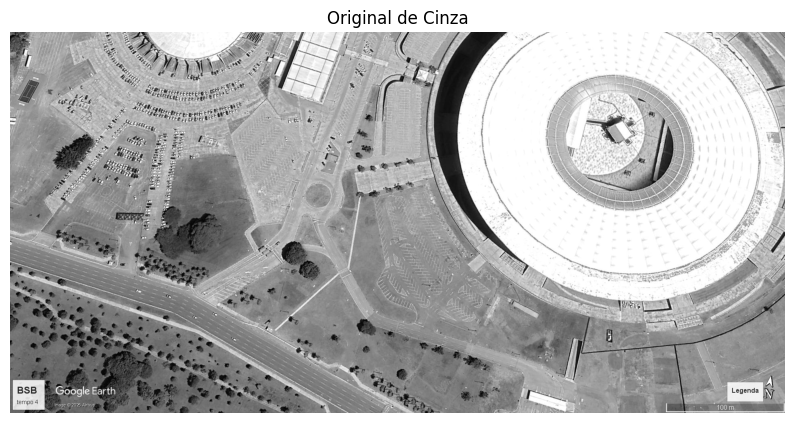

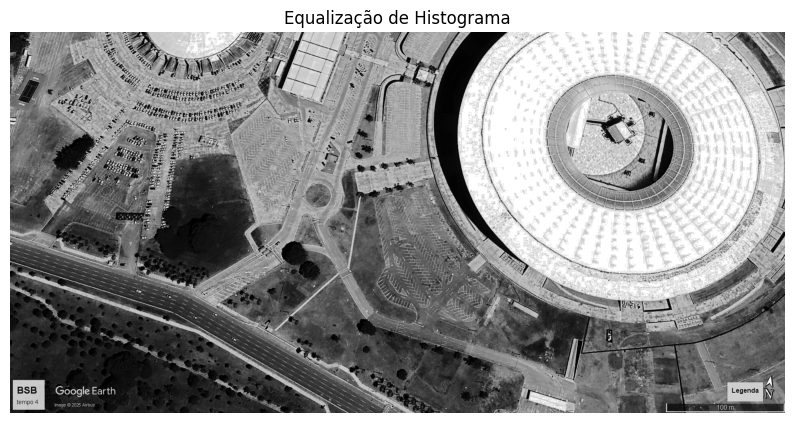

In [8]:
# Parte 2.2 – Aumento de Contraste
def equalize_histogram(image_gray):
    equalized = cv2.equalizeHist(image_gray)
    return equalized

equalized = equalize_histogram(gray)
show_image("Original de Cinza", gray, True)
show_image("Equalização de Histograma", equalized, True)


## 🌀 Low Pass Filter (Filtro Passa-Baixa)
O **Low Pass Filter** suaviza a imagem, reduzindo ruídos e detalhes finos.

- Exemplo: **Blur (desfoque)**.
- Aplicações:
  - Reduzir ruído antes de detecção de bordas.
  - Suavizar transições abruptas.
- Em OpenCV: `cv2.GaussianBlur()` ou `cv2.blur()`.

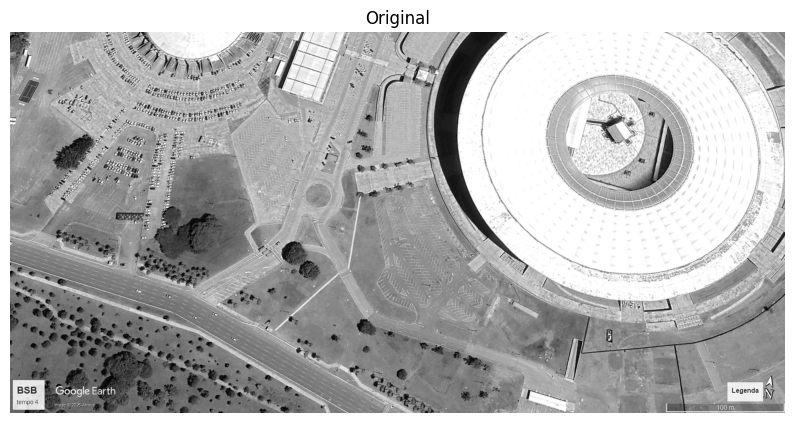

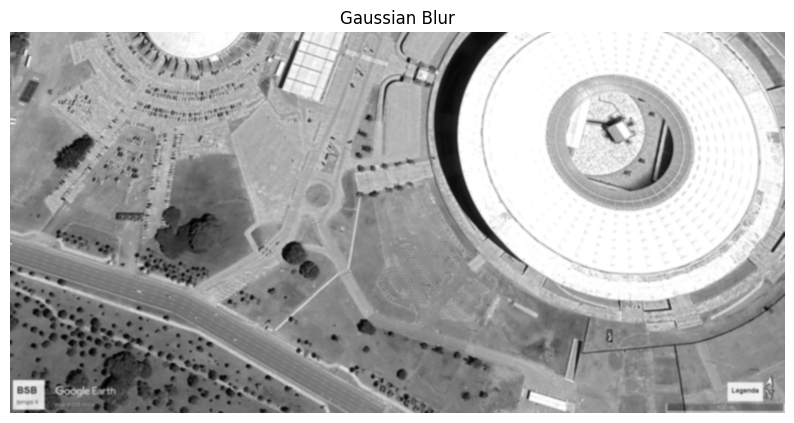

In [9]:
# Parte 2 Filtros - desfoque e realce

def apply_blurs(image):
    blur = cv2.GaussianBlur(image, (9, 9), 2)
    return blur



# Aplicação
blur = apply_blurs(gray)

show_image("Original", gray, True)
show_image("Gaussian Blur", blur, True)


## 🎚️ Threshold (Limiarização)
O **threshold** converte uma imagem em tons de cinza para uma imagem **binária**.

- Define-se um valor limite, e:
  - Pixels acima do limite viram **branco (255)**.
  - Pixels abaixo viram **preto (0)**.
- Usado para separar objetos do fundo.
- Em OpenCV: `cv2.threshold(image, thresh_value, max_value, type)`.

Tipos comuns:
- `cv2.THRESH_BINARY`
- `cv2.THRESH_OTSU` (threshold automático)

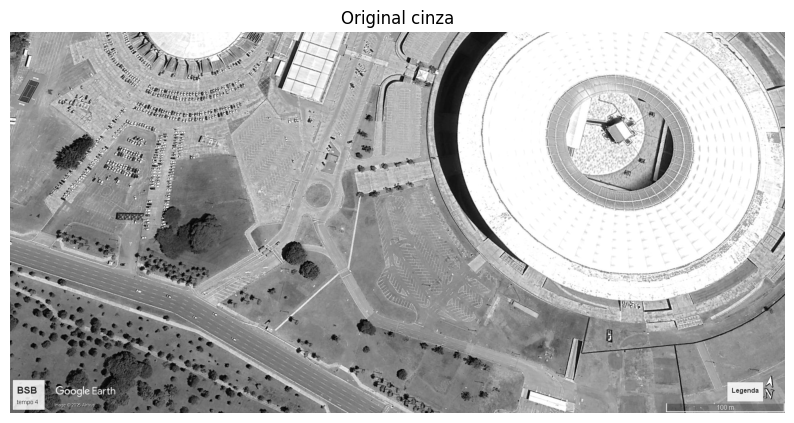

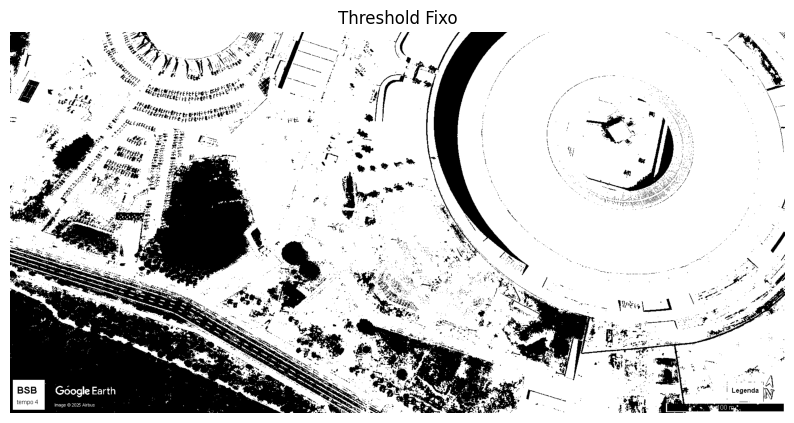

In [10]:
# Parte 4 Threshold e Binarização
def thresholding(image_gray):
    ret1, th = cv2.threshold(image_gray, 127, 255, cv2.THRESH_BINARY)
    return th

th = thresholding(gray)
show_image("Original cinza", gray, True)

show_image("Threshold Fixo", th, True)



#### Insight: Detectamos melhor a presença de uma pista na imagem 


## 🔺 High Pass Filter (Filtro Passa-Alta)
O **High Pass Filter** destaca bordas e mudanças bruscas de intensidade.

- Remove áreas suaves e realça detalhes.
- É a base para muitos detectores de bordas.
- Exemplo: Filtro Laplaciano e kernels personalizados.

---

## ✴️ Laplacian (Filtro Laplaciano)
O **Filtro Laplaciano** detecta bordas usando a **segunda derivada** da intensidade dos pixels.

- Identifica áreas com variações rápidas (bordas em qualquer direção).
- Sensível a ruídos, por isso é comum aplicar um blur antes.
- Em OpenCV: `cv2.Laplacian(image, cv2.CV_64F)`.

---

## ⚡ Canny (Detector de Bordas Canny)
O algoritmo **Canny** é um dos melhores detectores de bordas.

Etapas:
1. Aplicação de **Gaussian Blur**.
2. Cálculo do gradiente (bordas).
3. Supressão de não-máximos.
4. Aplicação de thresholds (duplo limiar).
5. Rastreamento de bordas.

- Em OpenCV: `cv2.Canny(image, threshold1, threshold2)`.

🔹 Thresholds definem a sensibilidade da detecção.

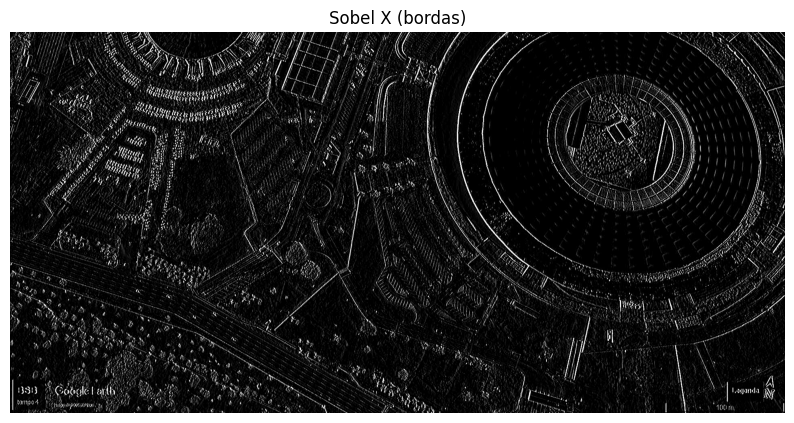

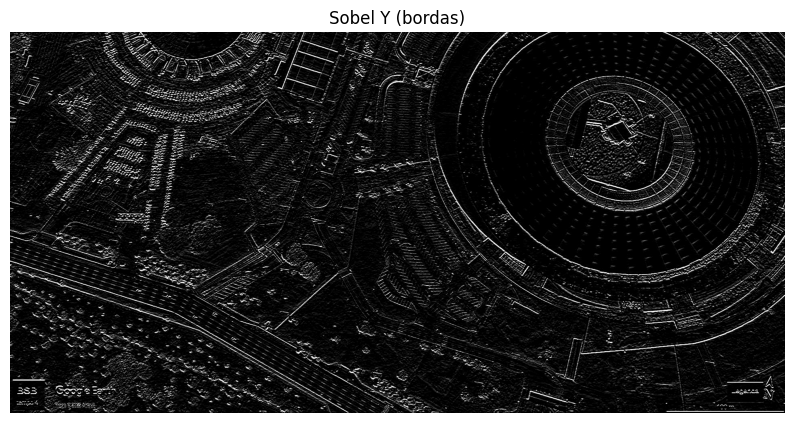

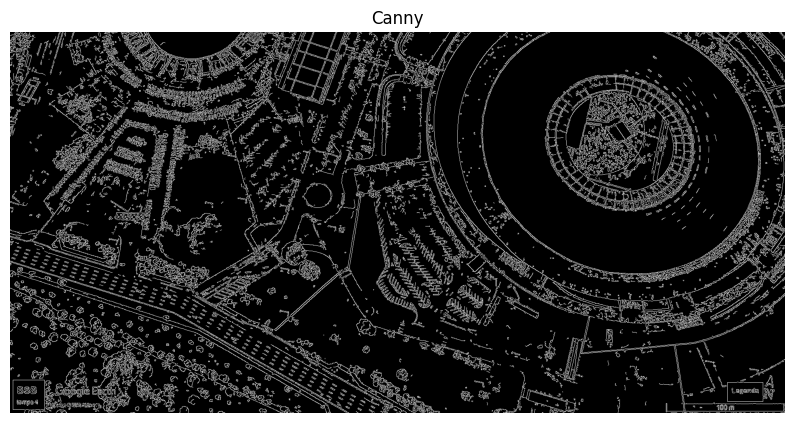

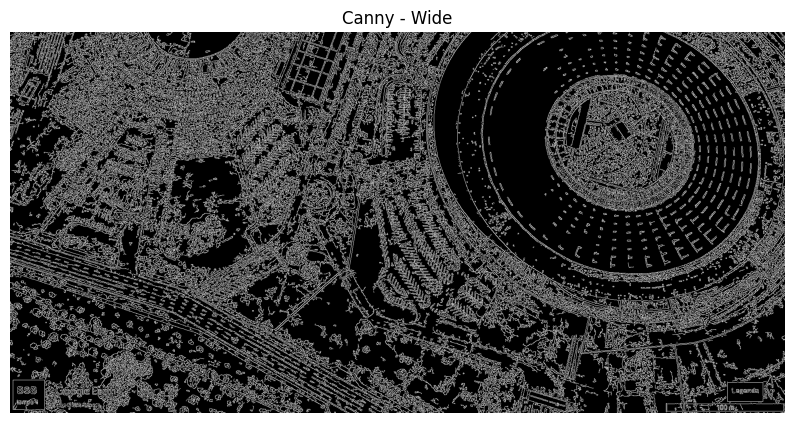

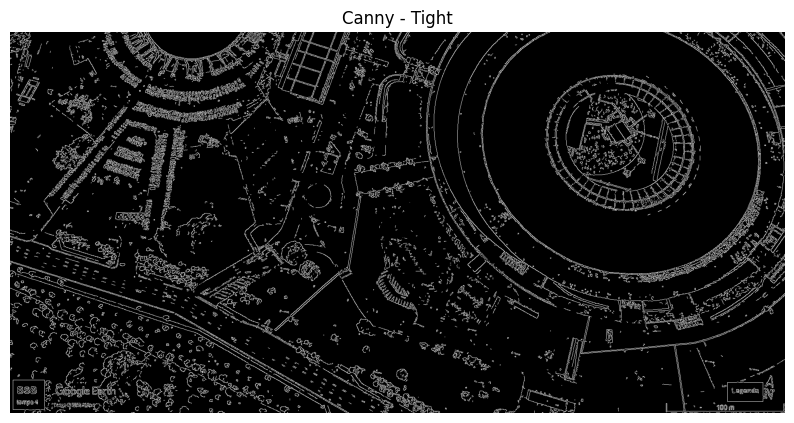

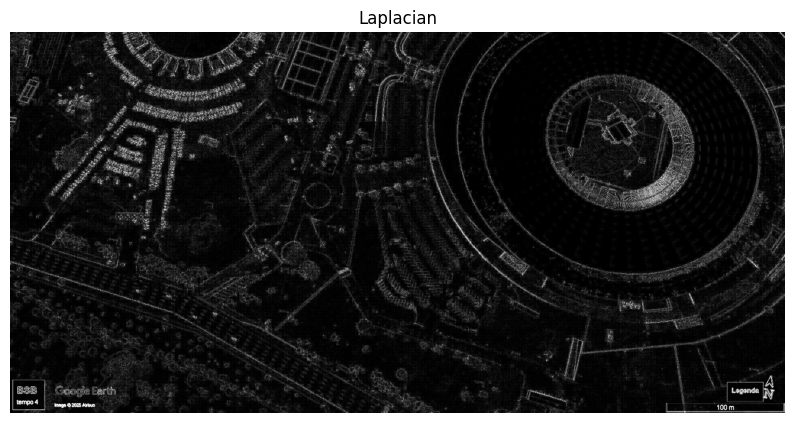

In [11]:
# 3x3 array for edge detection
sobel_y = np.array([[ -1, -2, -1], 
                   [ 0, 0, 0], 
                   [ 1, 2, 1]])


# 3x3 array for edge detection
sobel_x = np.array([[ -1, 0, 1], 
                   [ -2, 0, 2], 
                   [ -1, 0, 1]])

filtered_image = cv2.filter2D(gray, -1, sobel_x)



# Parte 3 Detecção de Bordas
def apply_sobel(image_gray):
    sobelx = cv2.filter2D(image_gray, -1, sobel_x)
    sobely = cv2.filter2D(image_gray, -1, sobel_y)
    return sobelx, sobely

def apply_canny(image_gray, threshold1=100, threshold2=200):
    wide = cv2.Canny(image_gray, 30, 100)
    tight = cv2.Canny(image_gray, 170, 255)
    canny = cv2.Canny(image_gray, threshold1, threshold2)
    return canny, wide , tight
    
# Função para aplicar o filtro Laplaciano
def apply_laplacian(image_gray):
    laplacian = cv2.Laplacian(image_gray, cv2.CV_64F)
    laplacian_abs = cv2.convertScaleAbs(laplacian)
    return laplacian_abs

# Aplicando Sobel
sobelx, sobely = apply_sobel(gray)
show_image("Sobel X (bordas)", sobelx, True)
show_image("Sobel Y (bordas)", sobely, True)

# Aplicando Canny
canny, wide, tight = apply_canny(gray)
show_image("Canny", canny, True)
show_image("Canny - Wide", wide, True)
show_image("Canny - Tight", tight, True)

# Aplicando Laplacian
laplacian = apply_laplacian(gray)
show_image("Laplacian", laplacian, True)



## ➖ Erosão, Dilatação, Abertura e Fechamento
Operações morfológicas aplicadas em imagens binárias:

- **Erosão**: Diminui áreas brancas, removendo pequenos ruídos.
- **Dilatação**: Expande áreas brancas, preenchendo falhas.
- **Abertura**: Erosão seguida de dilatação. Remove ruídos isolados.
- **Fechamento**: Dilatação seguida de erosão. Preenche buracos em objetos.

Em OpenCV: 
- `cv2.erode()`, `cv2.dilate()`, `cv2.morphologyEx()`.

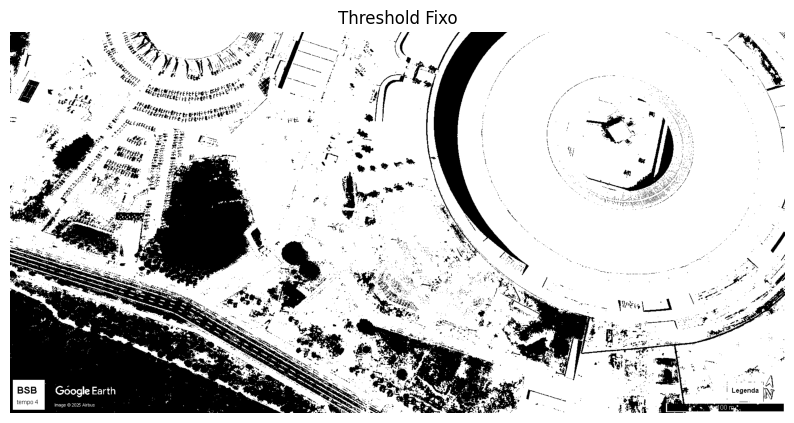

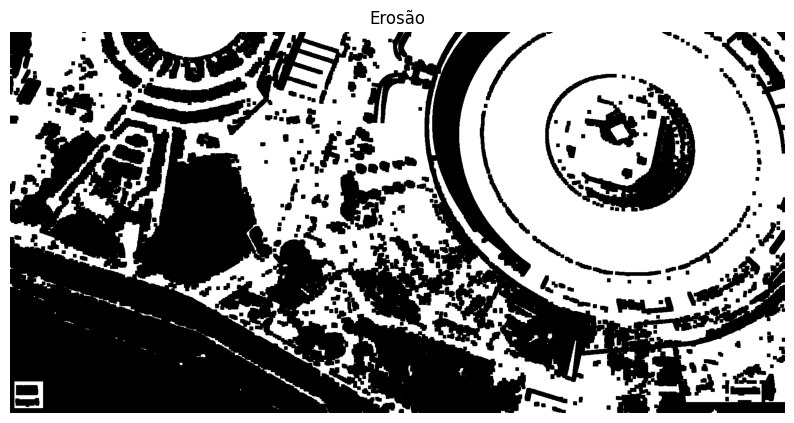

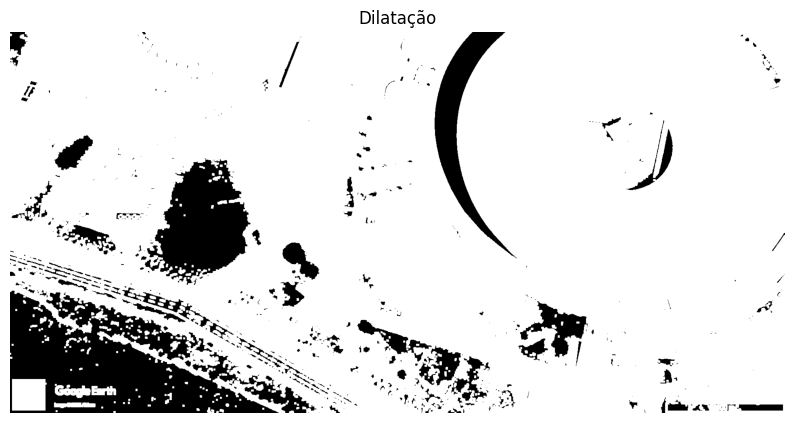

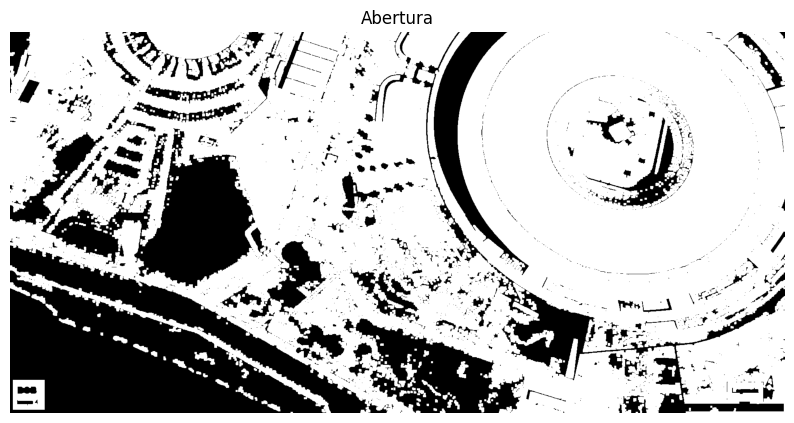

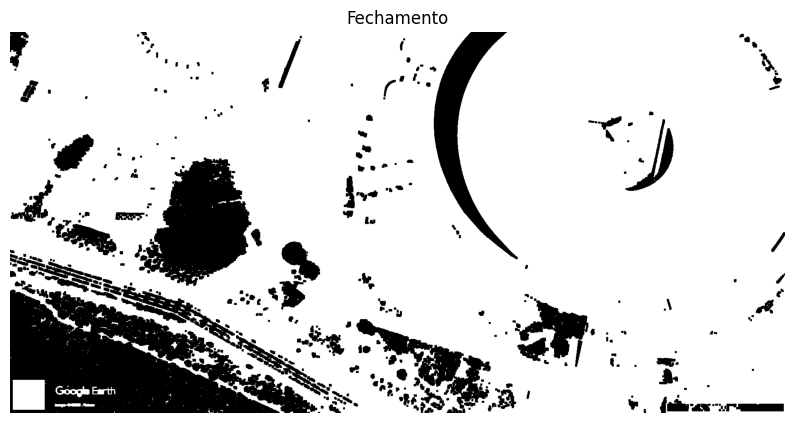

In [12]:
# Parte 5 – Morfologia: Erosão, Dilatação, Abertura, Fechamento
def morphology_ops(image_bin):
    kernel = np.ones((5,5), np.uint8)
    erosion = cv2.erode(image_bin, kernel, iterations=2)
    dilation = cv2.dilate(image_bin, kernel, iterations=1)
    opening = cv2.morphologyEx(image_bin, cv2.MORPH_OPEN, kernel)
    closing = cv2.morphologyEx(image_bin, cv2.MORPH_CLOSE, kernel)
    return erosion, dilation, opening, closing

erosion, dilation, opening, closing = morphology_ops(th)
show_image("Threshold Fixo", th, True)
show_image("Erosão", erosion, True)
show_image("Dilatação", dilation, True)
show_image("Abertura", opening, True)
show_image("Fechamento", closing, True)


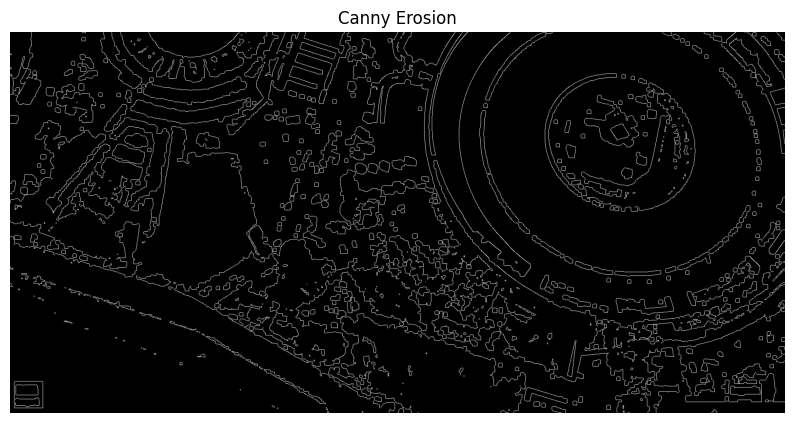

In [13]:
canny_erosion = cv2.Canny(erosion, 180, 255)

show_image("Canny Erosion", canny_erosion, True)

## 📐 Contornos e Formas
A detecção de **contornos** identifica os limites externos de objetos em uma imagem binária.

- Em OpenCV: `cv2.findContours()`.
- Permite medir:
  - Área
  - Perímetro
  - Detectar formas geométricas (círculo, quadrado).
- Pode-se usar `cv2.approxPolyDP` para simplificar formas.


🔹 Total de contornos detectados (após filtro): 47
➡️ Exibindo os 10 maiores contornos:

🔸 Contorno 1: Área = 493800.50, Perímetro = 5286.41, Circularidade = 0.22
🔸 Contorno 2: Área = 367567.50, Perímetro = 13113.45, Circularidade = 0.03
🔸 Contorno 3: Área = 79945.50, Perímetro = 8081.93, Circularidade = 0.02
🔸 Contorno 4: Área = 40468.00, Perímetro = 1462.42, Circularidade = 0.24
🔸 Contorno 5: Área = 11904.00, Perímetro = 1486.64, Circularidade = 0.07
🔸 Contorno 6: Área = 10312.50, Perímetro = 530.21, Circularidade = 0.46
🔸 Contorno 7: Área = 7070.50, Perímetro = 399.18, Circularidade = 0.56
🔸 Contorno 8: Área = 5130.50, Perímetro = 825.32, Circularidade = 0.09
🔸 Contorno 9: Área = 4828.00, Perímetro = 737.22, Circularidade = 0.11
🔸 Contorno 10: Área = 4550.00, Perímetro = 270.00, Circularidade = 0.78


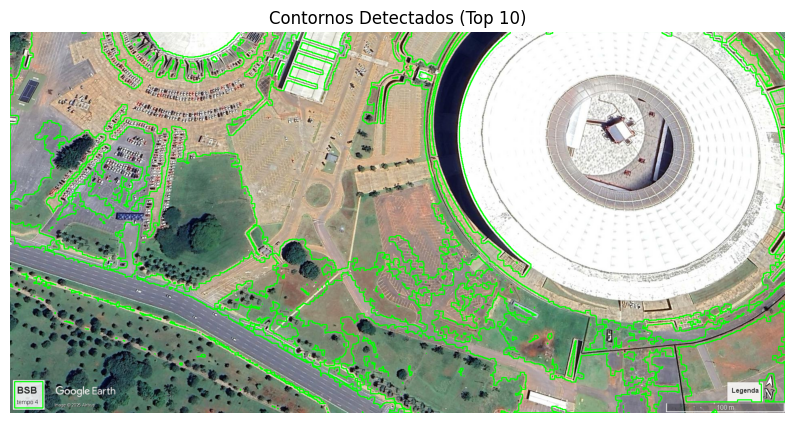

In [18]:
# Parte 6 – Detecção de Formas
# 📌 Função para Detectar Contornos (Formas Gerais)
def detect_shapes(image_gray, image_rgb):
    """
    Detecta contornos em uma imagem usando Canny e desenha sobre a imagem original.
    """
    # Detectar bordas com Canny
    edges = cv2.Canny(image_gray, 200, 240)
    
    # Encontrar contornos a partir das bordas
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Copiar imagem para desenhar contornos
    shapes = image_rgb.copy()
    cv2.drawContours(shapes, contours, -1, (0, 255, 0), 2)
    
    return shapes, contours


# 📌 Função para Detectar Linhas com Hough Transform
def detect_lines(image_gray, image_rgb):
    """
    Detecta linhas retas usando a Transformada de Hough e desenha sobre a imagem.
    """
    edges = cv2.Canny(image_gray, 200, 240)
    
    # Parâmetros da Transformada de Hough
    rho = 1
    theta = np.pi / 180
    threshold = 60
    min_line_length = 60
    max_line_gap = 5
    
    line_image = image_rgb.copy()
    
    lines = cv2.HoughLinesP(edges, rho, theta, threshold, np.array([]), min_line_length, max_line_gap)
    
    # Desenhar as linhas detectadas
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            cv2.line(line_image, (x1, y1), (x2, y2), (255, 0, 0), 3)
    
    return line_image


# 📌 Função para Detectar Círculos com HoughCircles
def detect_circles(image_gray, image_rgb):
    """
    Detecta círculos na imagem e desenha o contorno e o centro de cada círculo.
    """
    circles_im = image_rgb.copy()
    
    circles = cv2.HoughCircles(
        image_gray, 
        cv2.HOUGH_GRADIENT, 
        dp=1.2,            
        minDist=100,       
        param1=100,        
        param2=50,         
        minRadius=50,      
        maxRadius=300      
    )
    
    if circles is not None:
        circles = np.uint16(np.around(circles))
        for (x, y, r) in circles[0, :]:
            cv2.circle(circles_im, (x, y), r, (0, 255, 0), 3)   # Contorno do círculo
            cv2.circle(circles_im, (x, y), 5, (0, 0, 255), -1) # Centro do círculo
    
    return circles_im


# 📌 Função para Extrair Parâmetros das Formas
def extract_shape_parameters(contour):
    """
    Extrai diversos parâmetros geométricos de um contorno.
    """
    area = cv2.contourArea(contour)
    perimeter = cv2.arcLength(contour, True)
    circularity = 4 * np.pi * (area / (perimeter ** 2)) if perimeter != 0 else 0
    x, y, w, h = cv2.boundingRect(contour)
    aspect_ratio = float(w) / h if h != 0 else 0
    hull = cv2.convexHull(contour)
    solidity = float(area) / cv2.contourArea(hull) if cv2.contourArea(hull) != 0 else 0
    equivalent_diameter = np.sqrt(4 * area / np.pi) if area != 0 else 0
    
    # Elongação e Retangularidade (se possível ajustar uma elipse)
    if len(contour) >= 5:
        (_, _), (MA, ma), _ = cv2.fitEllipse(contour)
        elongation = MA / ma if ma != 0 else 0
    else:
        elongation = 0
    
    rectangularity = area / (w * h) if w * h != 0 else 0
    feret_diameter = max(cv2.minEnclosingCircle(contour)[1] * 2, 0)
    
    return {
        'Área': area,
        'Perímetro': perimeter,
        'Circularidade': circularity,
        'Aspect Ratio': aspect_ratio,
        'Solidez': solidity,
        'Diâmetro Equivalente': equivalent_diameter,
        'Alongamento': elongation,
        'Retangularidade': rectangularity,
        'Diâmetro de Feret': feret_diameter
    }


# 📌 Função para Exibir Resultados
def display_results(image_with_contours, contours, max_display=10, min_area=100):
    """
    Exibe a imagem com contornos e imprime parâmetros dos contornos mais relevantes.
    
    Parameters:
        image_with_contours (numpy.ndarray): Imagem com contornos desenhados.
        contours (list): Lista de contornos detectados.
        max_display (int): Número máximo de contornos a exibir.
        min_area (int): Área mínima para considerar o contorno.
    """
    # Filtrar contornos com área mínima
    filtered_contours = [c for c in contours if cv2.contourArea(c) > min_area]
    
    # Ordenar por área (decrescente)
    filtered_contours = sorted(filtered_contours, key=cv2.contourArea, reverse=True)
    
    # Limitar quantidade exibida
    display_contours = filtered_contours[:max_display]
    
    print(f"\n🔹 Total de contornos detectados (após filtro): {len(filtered_contours)}")
    print(f"➡️ Exibindo os {len(display_contours)} maiores contornos:\n")
    
    for idx, contour in enumerate(display_contours):
        params = extract_shape_parameters(contour)
        print(f"🔸 Contorno {idx + 1}: Área = {params['Área']:.2f}, Perímetro = {params['Perímetro']:.2f}, Circularidade = {params['Circularidade']:.2f}")
    
    # Exibir imagem
    plt.figure(figsize=(10, 5))
    plt.imshow(image_with_contours)
    plt.title(f'Contornos Detectados (Top {len(display_contours)})')
    plt.axis('off')
    plt.show()

# Detectar contornos na imagem (aplicando antes um threshold, se necessário)

contours, _ = cv2.findContours(erosion, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Desenhar contornos
contour_image = image_rgb.copy()
cv2.drawContours(contour_image, contours, -1, (0, 255, 0), 2)

# Exibir resultados
display_results(contour_image, contours)


## 🏁 Cantos (Corners)
Detectores de **cantos** encontram pontos onde há variação forte em duas direções.

- Exemplo: cruzamentos de linhas ou bordas.
- Algoritmos:
  - **Harris Corner Detector**
  - **Shi-Tomasi (GoodFeaturesToTrack)**

Aplicações:
- Rastreamento de objetos.
- Reconhecimento de padrões.

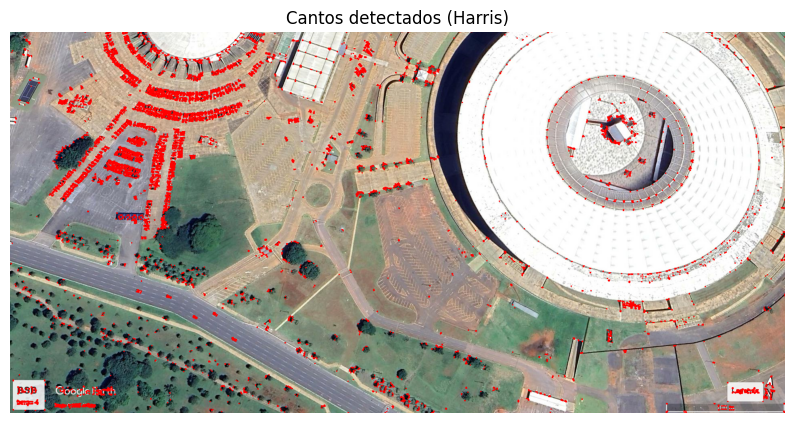

In [19]:
# Parte 7 – Detecção de Canto (Harris)
def detect_corners(image_gray):
    gray_float = np.float32(image_gray)
    corners = cv2.cornerHarris(gray_float, 2, 3, 0.04)
    corners = cv2.dilate(corners, None)
    corner_img = image_rgb.copy()
    corner_img[corners > 0.01 * corners.max()] = [255, 0, 0]
    return corner_img

corner_img = detect_corners(gray)
show_image("Cantos detectados (Harris)", corner_img, False)


## 🎨 K-Means (Segmentação de Imagem)
O **K-Means** é um algoritmo de clusterização que agrupa pixels semelhantes.

- Usado para:
  - **Segmentação de cores**.
  - Redução de cores (quantização).
- O usuário define o número de clusters (**K**).
- Em OpenCV: Usa-se `cv2.kmeans()`.

Exemplo:
- Reduzir uma imagem para 3 cores dominantes.


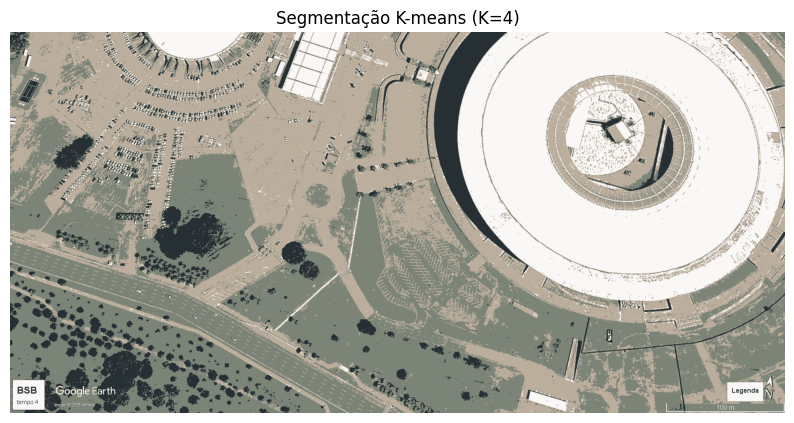

In [20]:
# Parte 8 – Segmentação com K-Means

def kmeans_segmentation(image_rgb, K=3):
    Z = image_rgb.reshape((-1, 3))
    Z = np.float32(Z)
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.2)
    _, labels, centers = cv2.kmeans(Z, K, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
    centers = np.uint8(centers)
    segmented = centers[labels.flatten()]
    segmented_image = segmented.reshape(image_rgb.shape)
    return segmented_image, labels

seg_img, labels = kmeans_segmentation(image_rgb, K=4)
show_image("Segmentação K-means (K=4)", seg_img, False)


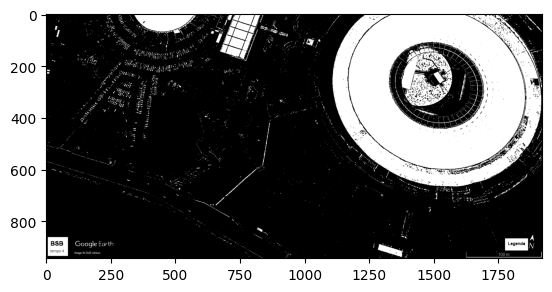

In [21]:
labels_reshape = labels.reshape(seg_img.shape[0], seg_img.shape[1])

plt.imshow(labels_reshape==0, cmap='gray')

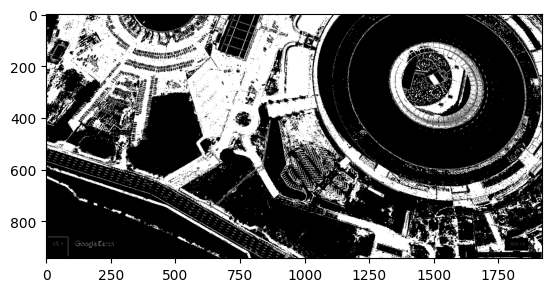

In [22]:

plt.imshow(labels_reshape==1, cmap='gray')


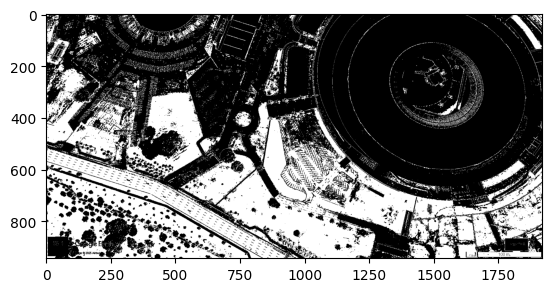

In [23]:

plt.imshow(labels_reshape==2, cmap='gray')


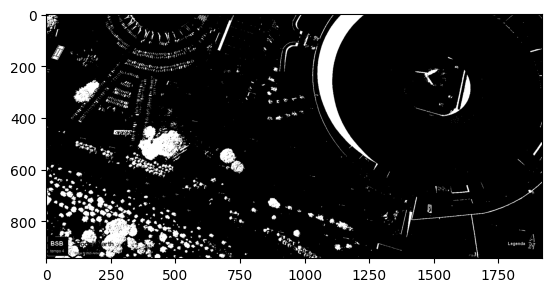

In [24]:

plt.imshow(labels_reshape==3, cmap='gray')


### 📌 **Localizando Keypoints com ORB**

O primeiro passo do algoritmo **ORB** é localizar todos os **keypoints** (pontos de interesse) na imagem. Após localizados, o ORB cria vetores binários de características para cada keypoint e agrupa tudo no chamado **descritor ORB**.

Para isso, usamos a classe `ORB` do OpenCV. A configuração do algoritmo é feita através da função `cv2.ORB_create()`, que possui vários parâmetros ajustáveis. Abaixo está a explicação de cada um:

---

### ⚙️ **Parâmetros do `cv2.ORB_create()`**

```python
cv2.ORB_create(
    nfeatures = 500,
    scaleFactor = 1.2,
    nlevels = 8,
    edgeThreshold = 31,
    firstLevel = 0,
    WTA_K = 2,
    scoreType = cv2.ORB_HARRIS_SCORE,
    patchSize = 31,
    fastThreshold = 20
)
```

| Parâmetro        | Descrição |
|------------------|-----------|
| **nfeatures**    | Número máximo de keypoints a serem detectados. |
| **scaleFactor**  | Fator de redução entre os níveis da pirâmide de imagens. Valores maiores reduzem a quantidade de features detectadas. |
| **nlevels**      | Número de níveis da pirâmide de imagens (multi-escala). |
| **edgeThreshold**| Tamanho da borda da imagem onde não serão buscados keypoints, evitando detectar pontos muito próximos das extremidades. |
| **firstLevel**   | Define qual nível da pirâmide será considerado o primeiro (normalmente é 0). |
| **WTA_K**        | Quantidade de pixels aleatórios usados para criar cada elemento do descritor BRIEF orientado (valores possíveis: 2, 3 ou 4). |
| **scoreType**    | Método de avaliação dos keypoints: `HARRIS_SCORE` (mais estável) ou `FAST_SCORE` (mais rápido, porém menos estável). |
| **patchSize**    | Tamanho do "bloco" (patch) ao redor de cada keypoint usado na geração do descritor. |
| **fastThreshold**| Limite de sensibilidade do detector FAST para detectar cantos. |

---

### 🎯 **Principais Ajustes**
- Os dois parâmetros que você provavelmente mais vai modificar são:
  - **nfeatures** (quantidade de keypoints desejada).
  - **scaleFactor** (controle da escala na pirâmide de imagens).
- Os demais podem, na maioria dos casos, ser deixados nos valores padrão para obter bons resultados.

---

### 🚀 **Exemplo de Uso**
No exemplo citado, o código ajusta:
- **200 keypoints** como máximo.
- Fator de escala da pirâmide para **2.1**.

Depois, utiliza:
- `detectAndCompute(image)` para detectar os keypoints e calcular os descritores ORB.
- `cv2.drawKeypoints()` para **visualizar** os pontos detectados na imagem.

---

### ✅ **Tradução Final**
O ORB funciona detectando pontos de interesse e gerando descritores binários para eles. A função `cv2.ORB_create()` permite configurar o comportamento do algoritmo, especialmente o número de keypoints e como ele lida com diferentes escalas da imagem. Após a detecção, é possível visualizar esses pontos desenhados sobre a imagem.

Se quiser, posso te mostrar esse código em funcionamento com uma imagem qualquer para você ver os keypoints detectados. Quer um exemplo prático?

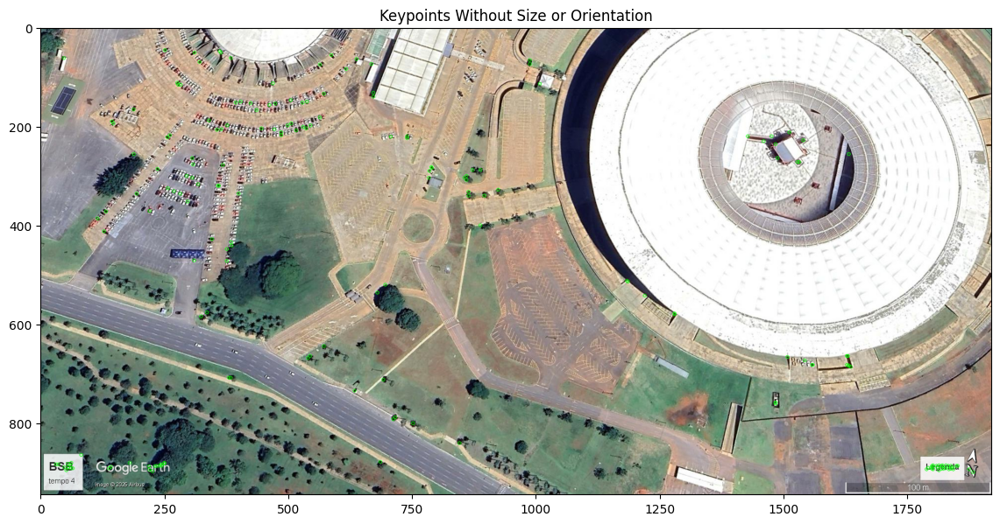

In [130]:
# Import copy to make copies of the training image
import copy

# Set the default figure size
plt.rcParams['figure.figsize'] = [14.0, 7.0]

# Set the parameters of the ORB algorithm by specifying the maximum number of keypoints to locate and
# the pyramid decimation ratio
orb = cv2.ORB_create(200, 2.0)

# Find the keypoints in the gray scale training image and compute their ORB descriptor.
# The None parameter is needed to indicate that we are not using a mask.
keypoints, descriptor = orb.detectAndCompute(gray, None)

# Create copies of the training image to draw our keypoints on
keyp_without_size = copy.copy(image_rgb)
keyp_with_size = copy.copy(image_rgb)

# Draw the keypoints without size or orientation on one copy of the training image 
cv2.drawKeypoints(image_rgb, keypoints, keyp_without_size, color = (0, 255, 0))

# Draw the keypoints with size and orientation on the other copy of the training image
cv2.drawKeypoints(image_rgb, keypoints, keyp_with_size, flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)


plt.title('Keypoints Without Size or Orientation')
plt.imshow(keyp_without_size)



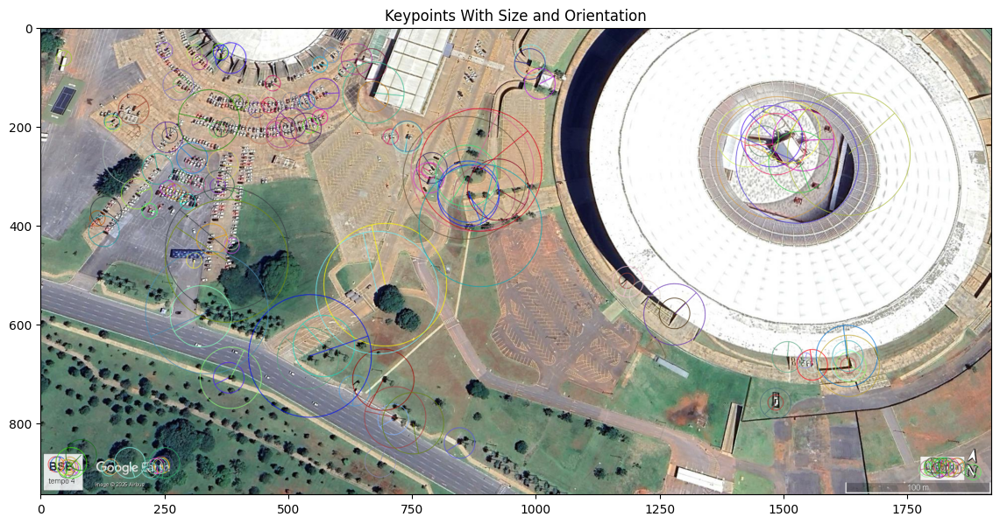


Number of keypoints Detected:  188


In [131]:
plt.title('Keypoints With Size and Orientation')
plt.imshow(keyp_with_size)
plt.show()

# Print the number of keypoints detected
print("\nNumber of keypoints Detected: ", len(keypoints))

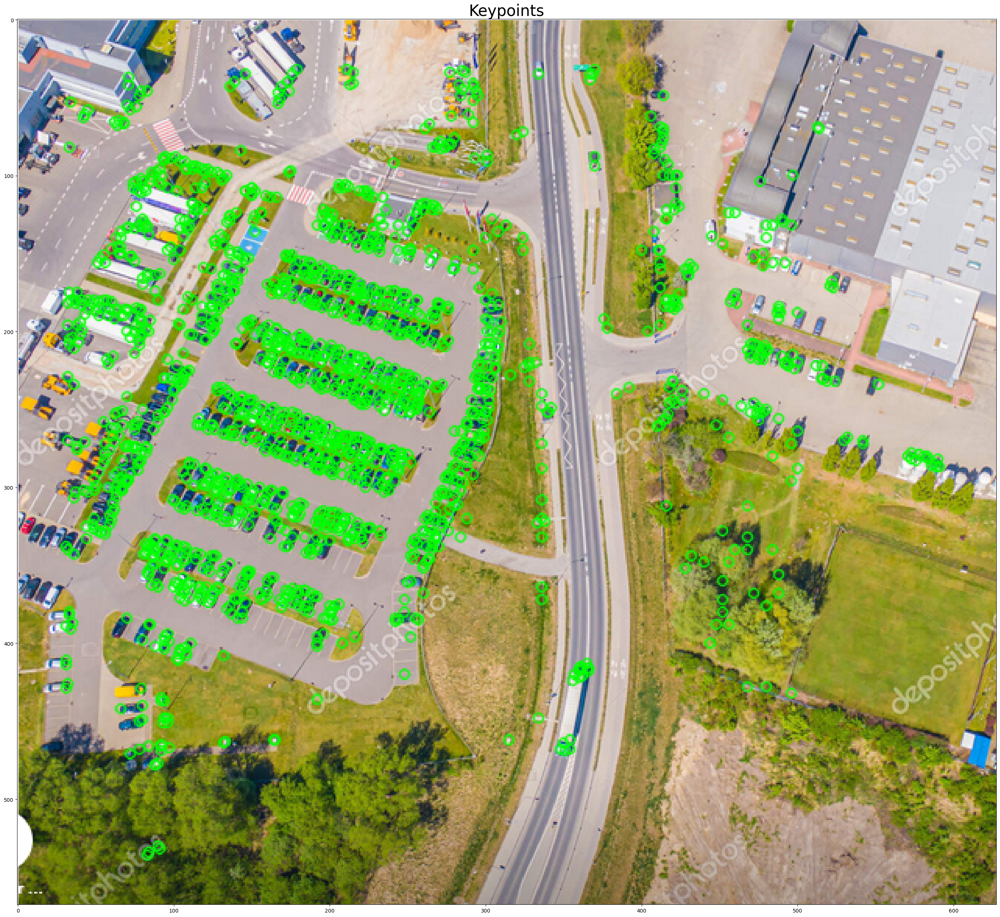


Number of keypoints Detected:  1764


In [158]:
# Set the default figure size
plt.rcParams['figure.figsize'] = [34.0, 34.0]

# Load the query image
image2 = cv2.imread('./D/queryImage.png')

# Convert the query image to RGB
query_image = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)
# Convert the query image to gray scale
query_gray = cv2.cvtColor(query_image, cv2.COLOR_BGR2GRAY)


# Set the parameters of the ORB algorithm by specifying the maximum number of keypoints to locate and
# the pyramid decimation ratio
orb = cv2.ORB_create(2000, 2.0)

# Find the keypoints in the gray scale training and query images and compute their ORB descriptor.
# The None parameter is needed to indicate that we are not using a mask in either case.  
keypoints_train, descriptors_train = orb.detectAndCompute(gray, None)
keypoints_query, descriptors_query = orb.detectAndCompute(query_gray, None)

# Create copies of the query images to draw our keypoints on
query_img_keyp = copy.copy(query_image)

# Draw the keypoints with size and orientation on the copy of the query image
cv2.drawKeypoints(query_image, keypoints_query, query_img_keyp, color = (0, 255, 0))

# Display the query image with the keypoints with size and orientation
plt.title('Keypoints', fontsize = 30)
plt.imshow(query_img_keyp)
plt.show()

# Print the number of keypoints detected
print("\nNumber of keypoints Detected: ", len(keypoints_query))


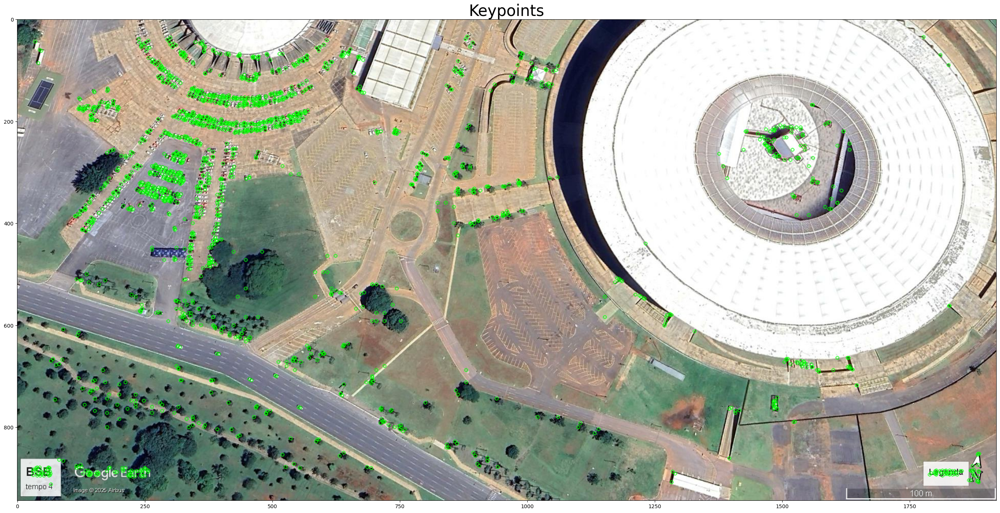


Number of keypoints Detected:  1882


In [159]:
# Draw the keypoints with size and orientation on the copy of the query image
cv2.drawKeypoints(image_rgb, keypoints_train, keyp_without_size, color = (0, 255, 0))

# Display the query image with the keypoints with size and orientation
plt.title('Keypoints', fontsize = 30)
plt.imshow(keyp_without_size)
plt.show()

# Print the number of keypoints detected
print("\nNumber of keypoints Detected: ", len(keypoints_train))


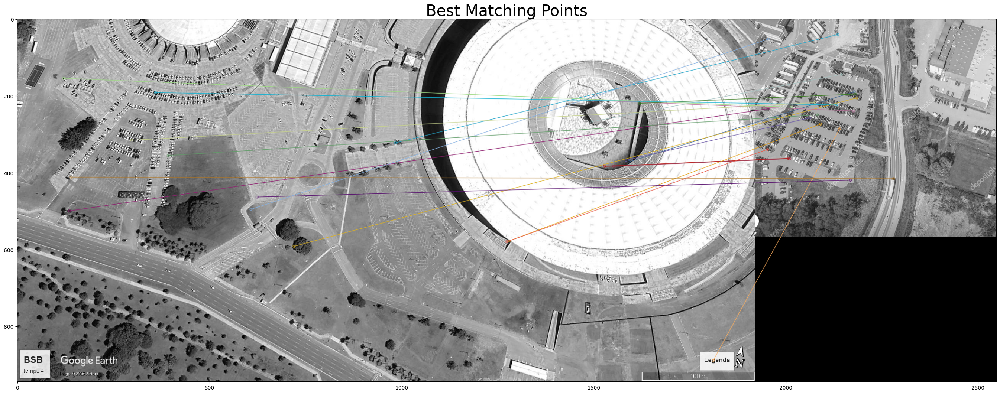

Number of Keypoints Detected In The Training Image:  1882
Number of Keypoints Detected In The Query Image:  1764

Number of Matching Keypoints Between The Training and Query Images:  475


In [162]:
# Set the default figure size
plt.rcParams['figure.figsize'] = [34.0, 34.0]

# Create a Brute Force Matcher object. We set crossCheck to True so that the BFMatcher will only return consistent
# pairs. Such technique usually produces best results with minimal number of outliers when there are enough matches.
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck = True)

# Perform the matching between the ORB descriptors of the training image and the query image
matches = bf.match(descriptors_train, descriptors_query)

# The matches with shorter distance are the ones we want. So, we sort the matches according to distance
matches = sorted(matches, key = lambda x : x.distance)

# Connect the keypoints in the training image with their best matching keypoints in the query image.
# The best matches correspond to the first elements in the sorted matches list, since they are the ones
# with the shorter distance. We draw the first 85 mathces and use flags = 2 to plot the matching keypoints
# without size or orientation.
result = cv2.drawMatches(gray, keypoints_train, query_gray, keypoints_query, matches[:20], query_gray, flags = 2)

# we display the image
plt.title('Best Matching Points', fontsize = 30)
plt.imshow(result)
plt.show()

# Print the number of keypoints detected in the training image
print("Number of Keypoints Detected In The Training Image: ", len(keypoints_train))

# Print the number of keypoints detected in the query image
print("Number of Keypoints Detected In The Query Image: ", len(keypoints_query))

# Print total number of matching Keypoints between the training and query images
print("\nNumber of Matching Keypoints Between The Training and Query Images: ", len(matches))